# demo: lesioning face-selective units in torchvision models
#### jacob prince - 04/09/20

### procedure:

1) define custom lesioning model that inherits modules from a source network and accepts masks for each layer defining which, if any, units should have their activation set to 0 during a forward pass.

2) load model (alexnet/vgg16; no lesioning) and save activations to localizer images (20 faces, 20 scenes)

3) conduct floc experiment using data from #2 to define selective units; output is a selectivity mask for each layer

4) load new model (same arch; with lesioning) and save activations to test images (here, the same localizer set), with all face-selective units in the network lesioned

5) visualize activations to verify that lesioning was successful


## imports

In [32]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import scipy.stats as stats
import os
from os.path import exists, join
import sys
from tqdm import tqdm
import time
import torch
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Subset
from torch.utils.data.dataset import Dataset
from torch.utils.data.sampler import SubsetRandomSampler
import torchvision.models as models
import torchvision.datasets as datasets 
from torchsummary import summary
from torch.autograd import Variable as V
from torch.nn import functional as F
import torch.nn  as nn
from PIL import Image
from IPython.core.debugger import set_trace
import scipy.io as sio
from time import sleep
import gc
import copy

import importlib
import nnutils as utils
import floc_selectivity as fs
import rsatools as rsa
import lesion as lsn

importlib.reload(fs)
importlib.reload(utils)
importlib.reload(rsa)
importlib.reload(lsn)

<module 'lesion' from '/home/jacobpri/git/RotspaceIT/notebooks/lesion.py'>

In [33]:
if torch.cuda.is_available():
    torch.cuda.empty_cache()

device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 

!nvidia-smi

Fri Apr 24 22:53:49 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 430.50       Driver Version: 430.50       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  GeForce GTX TIT...  Off  | 00000000:02:00.0 Off |                  N/A |
| 22%   39C    P8    17W / 250W |    743MiB / 12212MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [11]:
# current implementation works for alexnet and vgg16
# close to working for resnet18 but they implement downsampling in a complicated way
arch = 'alexnet'
trained_on = 'object'
imageset = 'imagefiles-fullset'
img_dim = 224
batch_size = 50
FDR_threshold = 0.05
val_batch_size = 1000
subset_by = 10
lesioning_method = 'sledgehammer' # sledgehammer, cascade-forward, cascade-backward, single-layer
randomize_lesions = True
target_layer = 'relu3'
lesion_domain = 'Faces'
overwrite = True

save_as = '.npy'
save_layer_rdvs = False
rdv_dist = 'correlation'
verbose = False
draw_plots = False

In [12]:
homedir = '/home/jacobpri/git/RotspaceIT/'
network = arch + '-' + trained_on
FDR_str = str(FDR_threshold).replace('.','_')
activation_savedir = join(homedir,'data','d02_modeling','activations',network,'localizer',imageset,'dim'+str(img_dim))
os.makedirs(activation_savedir,exist_ok=True)

In [13]:
imageset_dir = join(homedir,'imagesets','localizer',imageset)
assert(exists(imageset_dir))

val_imageset_dir = '/lab_data/tarrlab/common/datasets/ILSVRC/Data/CLS-LOC/val/'
assert(exists(val_imageset_dir))

floc_savedir = join(homedir,'data','d02_modeling','selectivity',network, 'localizer',imageset,'dim'+str(img_dim))
os.makedirs(floc_savedir,exist_ok=True)

utils.reproducible_results(365)

if lesioning_method == 'sledgehammer':
    target_str = ''
else:
    target_str = '_target-' + target_layer

lesion_resultsdir = join(homedir,'data','d02_modeling','lesioning',network,imageset)

results_str = f'LesionResults_dim-{img_dim}_FDR-{FDR_str}_subset-{subset_by}_method-{lesioning_method}_random-{str(randomize_lesions)}{target_str}_domain-{lesion_domain}'

os.makedirs(lesion_resultsdir,exist_ok=True)

print(results_str)

LesionResults_dim-224_FDR-0_05_subset-10_method-sledgehammer_random-True_domain-Faces


Computing network activations: 100%|██████████| 100.0/100 [00:54<00:00,  1.85it/s]


['Bodies', 'Faces', 'Objects', 'Scenes', 'Scrambled']
preference dict already exists. loading...
Faces
2161 inactive units in layer conv1
1456 inactive units in layer relu1
307 inactive units in layer maxpool1
10100 inactive units in layer conv2
2242 inactive units in layer relu2
1051 inactive units in layer maxpool2
11078 inactive units in layer conv3
2787 inactive units in layer relu3
7653 inactive units in layer conv4
3396 inactive units in layer relu4
3669 inactive units in layer conv5
1523 inactive units in layer relu5
682 inactive units in layer maxpool5
682 inactive units in layer avgpool5
682 inactive units in layer drop5
696 inactive units in layer fc6
439 inactive units in layer relu6
439 inactive units in layer drop6
512 inactive units in layer fc7
187 inactive units in layer relu7
0 inactive units in layer fc8
Fri Apr 24 22:03:59 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 430.50       Driver Version: 430.50      

Computing validation accuracy: 100%|██████████| 100.0/100 [01:53<00:00,  1.13s/it]
/home/jacobpri/git/RotspaceIT/notebooks/lesion.py:240: RuntimeWarning: Mean of empty slice
  c_acts[c] = np.nanmean(all_mean_acts[idx])
Computing validation accuracy: 100%|██████████| 100.0/100 [00:34<00:00,  2.91it/s]


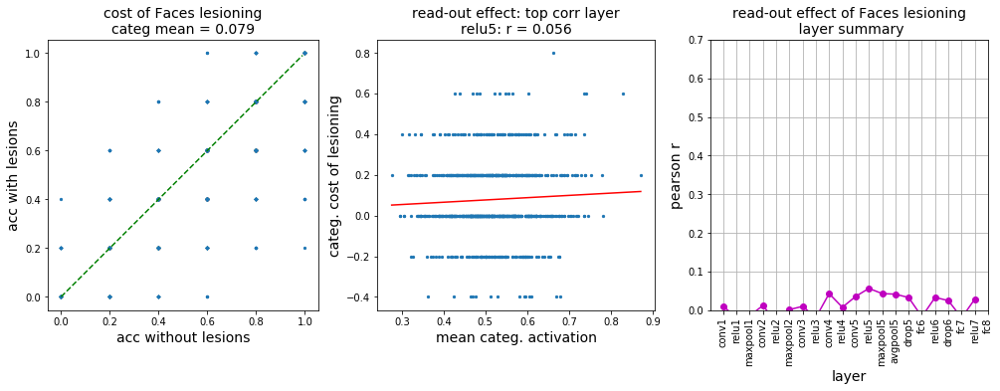

<Figure size 432x288 with 0 Axes>

In [15]:
if exists(join(lesion_resultsdir,f'{results_str}.npy')) and overwrite is False:
    print('result already exists. skipping.')
else:

    lesioning_domains = [lesion_domain]#,'Scenes','Objects','Bodies','Scrambled']#,'Scenes','Objects','Bodies','Scrambled']

    weight_dir =  join(homedir,'data','d02_modeling','weights')
    
    if arch == 'alexnet':
        src_model = models.alexnet()
        if trained_on == 'object':
            checkpoint = torch.load(os.path.join(weight_dir,'alexnet_imagenet_final.pth.tar'),map_location='cpu')
            checkpoint['state_dict'] = {str.replace(k,'module.',''): v for k,v in checkpoint['state_dict'].items()}
            src_model.load_state_dict(checkpoint['state_dict'])
    if arch == 'vgg16':
        if trained_on == 'object':
            src_model = models.vgg16(pretrained=True)

    # convert relus from in-place to not in-place so preceding layer acts are preserved
    utils.convert_relu(src_model) 

    # create empty masks object
    masks = dict()
    masks['apply'] = False

    # initialize lesioning model using modules from source network
    model = lsn.LesionNet(src_model, masks)

    if torch.cuda.is_available():
        model.to(device)

    #print(model)
    
    ####################

    dataset = datasets.ImageFolder(root = imageset_dir)

    # normalize images using parameters from the training image set
    data_transform = transforms.Compose([       
     transforms.Resize(img_dim),                   
     transforms.CenterCrop((img_dim,img_dim)),         
     transforms.ToTensor(),                    
     transforms.Normalize(                      
     mean=[0.485, 0.456, 0.406],                
     std=[0.229, 0.224, 0.225]                  
     )])

    # reload the dataset, this time applying the transform
    dataset =  datasets.ImageFolder(root = imageset_dir, transform = data_transform)

    # data loader object is required for passing images through the network - choose batch size and num workers here
    data_loader = torch.utils.data.DataLoader(
        dataset,
        batch_size=batch_size,
        num_workers=12,
        shuffle=False
    )

    ######################

    utils.extract_and_save_activations(model,
                                       device,
                                       data_loader, 
                                       model.layers, 
                                       model.layers_fmt, 
                                       activation_savedir,
                                       overwrite = overwrite,
                                       verbose = verbose)

    ########################

    # print some info -> verify correct # imgs, etc
    categ_idx = np.array(dataset.targets)
    floc_domains = dataset.classes ### be careful with this line
    
    print(floc_domains)
    
    #set_trace()
    
    FDR_str = str(FDR_threshold).replace('.','_')
    floc_str = f'layer_pref_dicts_FDR_{FDR_str}.npy'
    floc_fullsave_fn = join(floc_savedir,floc_str)

    ## run deepnet floc experiment, returning a dict with each layer's pref dict

    if exists(floc_fullsave_fn):
        print('preference dict already exists. loading...')
        pref_dicts = np.load(floc_fullsave_fn,allow_pickle=True).item()

    else:
        pref_dicts = dict()

        with tqdm(total=100,desc='Conducting deepnet floc experiments') as pbar:
            for layer in model.layers_fmt:

                time.sleep(0.1) 
                
                print(layer)

                Y = utils.load_batched_activations(activation_savedir, layer, batch_size, reshape_to_2D = True)
                # get selective units. FDR threshold is 0.05
                pref_dicts[layer] = fs.floc_selectivity(Y, categ_idx, FDR_threshold)

                pbar.update(100/len(model.layers_fmt))

        np.save(floc_fullsave_fn, pref_dicts)

    #########################

    domain_categ_sel_masks = dict()

    for lesioning_domain in lesioning_domains:

        print(lesioning_domain)

        lesioning_idx = [i for i in range(len(floc_domains)) if floc_domains[i] == lesioning_domain][0]

        categ_sel_masks = dict()

        for lay in range(len(model.layers)):
            mask = pref_dicts[model.layers_fmt[lay]]['domain_sel_masks'][lesioning_idx] # index 1 for faces
            Y = utils.load_batched_activations(activation_savedir, [model.layers_fmt[lay]], batch_size, reshape_to_2D = False)
            dims = Y.shape[1:]
            mask = np.reshape(mask,dims)
            categ_sel_masks[model.layers[lay]] = torch.Tensor(mask).to(device)

        # set apply parameter to true
        categ_sel_masks['apply'] = False
        categ_sel_masks['fc8'] = torch.Tensor(np.ones(categ_sel_masks['fc8'].shape)).to(device)

        #### right here: change the masks based on the lesioning method ####
        domain_categ_sel_masks[lesioning_domain] = lsn.set_lesioning_method(categ_sel_masks,
                                                                        lesioning_method,
                                                                        target_layer,
                                                                        randomize_lesions,
                                                                        model.layers, 
                                                                        device)

    if torch.cuda.is_available():
        torch.cuda.empty_cache()

    masks = dict()
    masks['apply'] = False

    model = lsn.LesionNet(src_model, masks) # inputs: source arch, masks

    utils.convert_relu(model)

    if torch.cuda.is_available():
        model.to(device)

    !nvidia-smi

    ###############

    results = dict()
    results['no_lesion'] = dict()

    # reload the dataset, this time applying the transform
    val_dataset =  datasets.ImageFolder(root = val_imageset_dir, transform = data_transform)
    
    #set_trace()

    val_subset_idx = list(range(0, len(val_dataset), subset_by))
    val_dataset = Subset(val_dataset, val_subset_idx)

    # data loader object is required for passing images through the network - choose batch size and num workers here
    val_data_loader = torch.utils.data.DataLoader(
        val_dataset,
        batch_size=val_batch_size,
        num_workers=12,
        shuffle=False
    )

    all_c_accs, all_layer_mean_acts = lsn.lesioning_validation_pass(model, 
                                                                    device, 
                                                                    val_dataset,
                                                                    val_data_loader,
                                                                    domain_categ_sel_masks)

    results['no_lesion']['accuracies'] = all_c_accs
    results['no_lesion']['selective_unit_acts'] = all_layer_mean_acts # in selective subsets only

    #####################

    for lesioning_domain in lesioning_domains:

        results[lesioning_domain] = dict()

        categ_sel_masks = domain_categ_sel_masks[lesioning_domain]
        categ_sel_masks['apply'] = True

        lesion_model = lsn.LesionNet(src_model,categ_sel_masks) # inputs: source arch, masks

        utils.convert_relu(lesion_model)

        if torch.cuda.is_available():
            lesion_model.to(device)

        all_c_accs, all_layer_mean_acts = lsn.lesioning_validation_pass(lesion_model, 
                                                                        device, 
                                                                        val_dataset,
                                                                        val_data_loader)

        results[lesioning_domain]['accuracies'] = all_c_accs
        results[lesioning_domain]['selective_unit_acts'] = all_layer_mean_acts # in selective subsets only 

        ##############

        costs = results['no_lesion']['accuracies'] - results[lesioning_domain]['accuracies']
        results[lesioning_domain]['costs'] = costs
        results[lesioning_domain]['mean_cost'] = np.nanmean(costs)

        plt.figure(figsize=(17,5))
        plt.subplot(131)
        plt.scatter(results['no_lesion']['accuracies'],results[lesioning_domain]['accuracies'],5)
        mean_cost = np.mean(costs)
        plt.axis('square')
        plt.plot(np.arange(0,1,0.01),np.arange(0,1,0.01),'g--')
        plt.xlabel('acc without lesions',fontsize=14)
        plt.ylabel('acc with lesions',fontsize=14)
        plt.title(f'cost of {lesioning_domain} lesioning\ncateg mean = {round(mean_cost,3)}',fontsize=14);

        corrs = []
        for i in range(len(model.layers)):
            lay = model.layers[i]
            x = results['no_lesion']['selective_unit_acts'][lesioning_domain][lay]
            y = results['no_lesion']['accuracies'] - results[lesioning_domain]['accuracies']
            corr = np.corrcoef(x,y)[1,0]
            corrs.append(round(corr,4))

        plt.subplot(133)
        plt.plot(np.arange(len(model.layers)),corrs,'mo-')
        plt.xticks(np.arange(len(model.layers)), model.layers, rotation = 90);
        plt.grid(True)
        plt.title(f'read-out effect of {lesioning_domain} lesioning\n layer summary',fontsize=14)
        plt.ylabel('pearson r',fontsize=14)
        plt.xlabel('layer',fontsize=14)
        plt.ylim([0,0.7])

        corrs = np.array(corrs)
        results[lesioning_domain]['readout_effect_corrs'] = corrs

        nan_idx = np.isnan(corrs)
        corrs[nan_idx] = 0
        max_idx = np.argmax(corrs)

        x = results['no_lesion']['selective_unit_acts'][lesioning_domain][model.layers[max_idx]]
        y = results['no_lesion']['accuracies'] - results[lesioning_domain]['accuracies']

        results[lesioning_domain]['topcorr_layer_acts'] = x

        plt.subplot(132)
        plt.scatter(x,y,5)
        plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)),'r')
        plt.title(f'read-out effect: top corr layer\n{model.layers[max_idx]}: r = {round(np.corrcoef(x,y)[1,0],3)}',
                 fontsize=14)
        plt.xlabel('mean categ. activation',fontsize=14)
        plt.ylabel('categ. cost of lesioning',fontsize=14)
        plt.show()

        figfn = '1_CategCost_ReadoutEffect_Summaries.png'
        plt.savefig(join(lesion_resultsdir,figfn),format='png')

        rankings = np.flip(np.argsort(costs))

        results[lesioning_domain]['cost_rankings'] = rankings

#         plot_rankings = copy.deepcopy(rankings)
#         img_rankings = copy.deepcopy(rankings)
#         for r in range(len(rankings)):
#             img_rankings[r] = rankings[r] * 50

#         data_transform_ = transforms.Compose([       
#          transforms.Resize(112),                   
#          transforms.CenterCrop((112,112))])

#         val_dataset_ =  datasets.ImageFolder(root = val_imageset_dir, transform = data_transform_)

#         p = 1000
#         plt.figure(figsize=(80,50))
#         c = 1
#         for i in range(p):
#             plt.subplot(25,40,c)
#             plt.imshow(val_dataset_[img_rankings[i]][0])
#             plt.xticks([])
#             plt.yticks([])
#             plt.axis('tight')
#             ax = plt.gca()
#             ax.get_xaxis().set_visible(False)
#             ax.get_yaxis().set_visible(False)
#             c += 1

#         figfn = '2_CategCostRanking_Montage.png'
#         plt.savefig(join(lesion_resultsdir,figfn),format='png')
        
        ########## SAVE RESULTS DICT ##########
        resfn = f'{results_str}.npy'
        np.save(join(lesion_resultsdir,resfn), results)
        
        

In [39]:
fn = join('/home/jacobpri/git/RotspaceIT/data/d02_modeling/lesioning/',
          'alexnet-object/imagefiles-fullset/',
          'LesionResults_dim-224_FDR-0_05_subset-1_method-sledgehammer_random-True_domain-Scenes.npy')

results = np.load(fn,allow_pickle=True).item()

print(results['Scenes']['mean_cost'])

0.05578


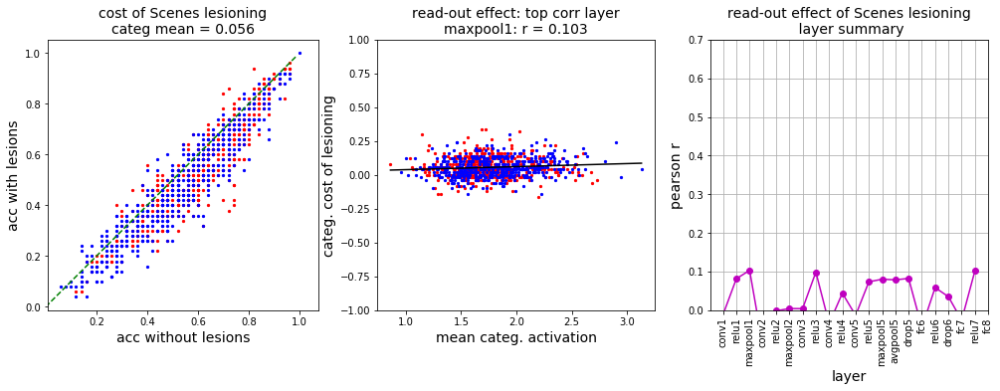

In [40]:
lesioning_domain = 'Scenes'

costs = results['no_lesion']['accuracies'] - results[lesioning_domain]['accuracies']

plt.figure(figsize=(17,5))
plt.subplot(131)
plt.scatter(results['no_lesion']['accuracies'][:500],results[lesioning_domain]['accuracies'][:500],5,'r')
plt.scatter(results['no_lesion']['accuracies'][500:],results[lesioning_domain]['accuracies'][500:],5,'b')
mean_cost = np.mean(costs)
plt.axis('square')
plt.plot(np.arange(0,1,0.01),np.arange(0,1,0.01),'g--')
plt.xlabel('acc without lesions',fontsize=14)
plt.ylabel('acc with lesions',fontsize=14)
plt.title(f'cost of {lesioning_domain} lesioning\ncateg mean = {round(mean_cost,3)}',fontsize=14);

corrs = []
for i in range(len(model.layers)):
    lay = model.layers[i]
    x = results['no_lesion']['selective_unit_acts'][lesioning_domain][lay]
    y = results['no_lesion']['accuracies'] - results[lesioning_domain]['accuracies']
    corr = np.corrcoef(x,y)[1,0]
    corrs.append(round(corr,4))

plt.subplot(133)
plt.plot(np.arange(len(model.layers)),corrs,'mo-')
plt.xticks(np.arange(len(model.layers)), model.layers, rotation = 90);
plt.grid(True)
plt.title(f'read-out effect of {lesioning_domain} lesioning\n layer summary',fontsize=14)
plt.ylabel('pearson r',fontsize=14)
plt.xlabel('layer',fontsize=14)
plt.ylim([0,0.7])

corrs = np.array(corrs)
#results[lesioning_domain]['readout_effect_corrs'] = corrs

nan_idx = np.isnan(corrs)
corrs[nan_idx] = 0
max_idx = np.argmax(corrs)

x = results['no_lesion']['selective_unit_acts'][lesioning_domain][model.layers[max_idx]]
y = results['no_lesion']['accuracies'] - results[lesioning_domain]['accuracies']

#results[lesioning_domain]['topcorr_layer_acts'] = x

plt.subplot(132)
plt.scatter(x[:500],y[:500],5,'r')
plt.scatter(x[500:],y[500:],5,'b')
plt.plot(np.unique(x), np.poly1d(np.polyfit(x, y, 1))(np.unique(x)),'k')
plt.title(f'read-out effect: top corr layer\n{model.layers[max_idx]}: r = {round(np.corrcoef(x,y)[1,0],3)}',
         fontsize=14)
plt.xlabel('mean categ. activation',fontsize=14)
plt.ylabel('categ. cost of lesioning',fontsize=14)
plt.ylim([-1,1])
plt.show()

#figfn = '1_CategCost_ReadoutEffect_Summaries.png'
#plt.savefig(join(lesion_resultsdir,figfn),format='png')


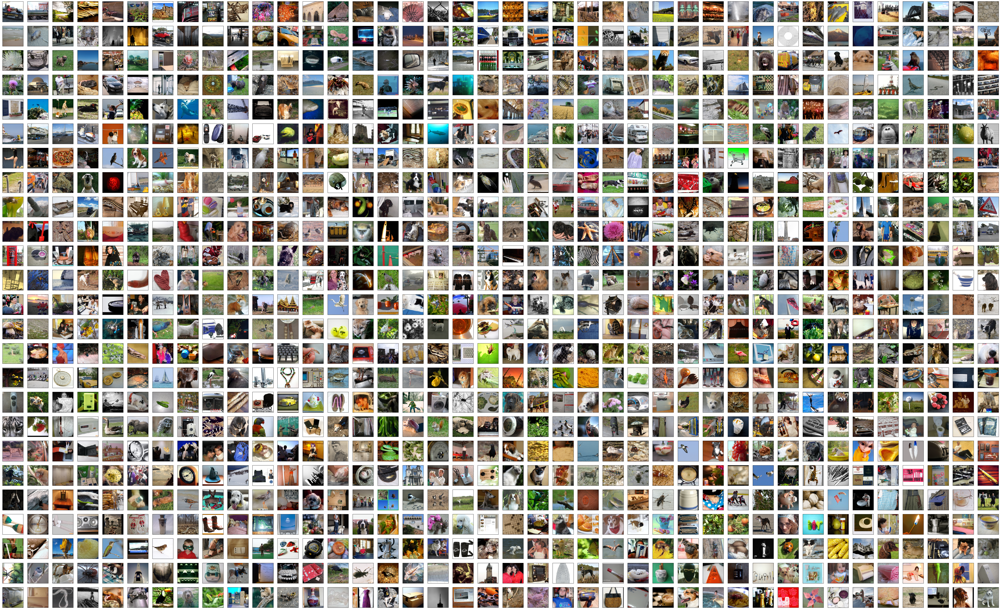

In [28]:
rankings = np.flip(np.argsort(costs))

results[lesioning_domain]['cost_rankings'] = rankings

plot_rankings = copy.deepcopy(rankings)
img_rankings = copy.deepcopy(rankings)
for r in range(len(rankings)):
    img_rankings[r] = rankings[r] * 50

data_transform_ = transforms.Compose([       
 transforms.Resize(112),                   
 transforms.CenterCrop((112,112))])

val_dataset_ =  datasets.ImageFolder(root = val_imageset_dir, transform = data_transform_)

p = 1000
plt.figure(figsize=(80,50))
c = 1
for i in range(p):
    plt.subplot(25,40,c)
    plt.imshow(val_dataset_[img_rankings[i]][0])
    plt.xticks([])
    plt.yticks([])
    plt.axis('tight')
    ax = plt.gca()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    c += 1

figfn = '2_CategCostRanking_Montage.png'
plt.savefig(join(lesion_resultsdir,figfn),format='png')

########## SAVE RESULTS DICT ##########
resfn = f'{results_str}.npy'
np.save(join(lesion_resultsdir,resfn), results)

In [30]:
np.squeeze(np.argwhere(domain_categ_sel_masks[lesioning_domain]['fc7'].cpu().numpy().reshape(-1) == 0))

array([   0,    1,   10,   15,   21,   24,   30,   34,   35,   69,   74,
         77,   86,   87,   88,   92,  101,  111,  115,  118,  125,  126,
        151,  175,  185,  203,  207,  209,  214,  219,  222,  226,  233,
        240,  253,  255,  257,  259,  266,  274,  279,  280,  313,  314,
        315,  316,  323,  343,  364,  365,  371,  376,  402,  419,  420,
        433,  439,  456,  459,  483,  493,  497,  498,  503,  518,  527,
        532,  533,  540,  543,  545,  548,  551,  560,  561,  584,  594,
        596,  598,  600,  622,  627,  635,  637,  644,  647,  653,  661,
        664,  670,  674,  692,  707,  709,  712,  724,  725,  728,  736,
        750,  757,  763,  764,  775,  786,  787,  791,  795,  796,  811,
        813,  817,  832,  862,  865,  884,  891,  905,  923,  931,  935,
        939,  940,  950,  958,  959,  961,  969,  998, 1003, 1015, 1022,
       1023, 1025, 1039, 1064, 1068, 1081, 1083, 1093, 1122, 1127, 1130,
       1131, 1137, 1139, 1146, 1161, 1163, 1164, 11